In [1]:
%matplotlib inline
import seaborn
import numpy, scipy, matplotlib.pyplot as plt, IPython.display as ipd
import librosa, librosa.display
plt.rcParams['figure.figsize'] = (13, 5)

[&larr; Back to Index](index.html)

# Onset-based Segmentation with Backtracking

[`librosa.onset.onset_detect`](http://librosa.github.io/librosa/generated/librosa.onset.onset_detect.html#librosa.onset.onset_detect) works by finding peaks in a spectral novelty function. However, these peaks may not actually coincide with the initial rise in energy or how we perceive the beginning of a musical note.

The optional keyword parameter `backtrack=True` will backtrack from each peak to a preceding local minimum. Backtracking can be useful for finding segmentation points such that the onset occurs shortly after the beginning of the segment. We will use `backtrack=True` to perform onset-based segmentation of a signal.

Load an audio file into the NumPy array `x` and sampling rate `sr`. 

In [43]:
x, sr = librosa.load('/Users/kcfdaniel/Downloads/fyp/Sum_41_Walking Disaster_percussive.wav', sr =44100 )
print x.shape, sr

(1068651,) 44100


Listen:

In [44]:
ipd.Audio(x, rate=sr)

Compute the frame indices for estimated onsets in a signal:

In [45]:
hop_length = 512
onset_frames = librosa.onset.onset_detect(x, sr=sr, hop_length=hop_length)
print onset_frames # frame numbers of estimated onsets

[   4   20   31   37   51   67   99  117  131  141  145  162  176  192  215
  224  240  244  256  272  289  303  314  319  340  350  369  380  383  397
  414  429  445  462  476  479  492  499  508  524  539  556  569  572  587
  602  623  627  635  647  666  681  697  711  714  729  745  751  754  761
  776  793  807  823  844  855  874  887  901  918  933  947  950  980  996
 1013 1028 1045 1059 1075 1097 1107 1126 1139 1151 1154 1170 1184 1201 1232
 1249 1265 1280 1297 1312 1324 1328 1359 1378 1389 1392 1406 1422 1437 1453
 1485 1501 1508 1517 1532 1548 1564 1579 1595 1611 1631 1643 1655 1674 1688
 1705 1720 1737 1740 1753 1759 1769 1784 1801 1816 1831 1852 1863 1882 1895
 1910 1926 1941 1956 1975 1989 2005 2012 2028 2039 2051 2056 2060 2071]


Convert onsets to units of seconds:

In [46]:
onset_times = librosa.frames_to_time(onset_frames, sr=sr, hop_length=hop_length)
print onset_times

[  0.04643991   0.23219955   0.3599093    0.42956916   0.59210884
   0.77786848   1.14938776   1.35836735   1.52090703   1.6370068
   1.68344671   1.88081633   2.04335601   2.22911565   2.49614512
   2.60063492   2.78639456   2.83283447   2.9721542    3.15791383
   3.35528345   3.51782313   3.64553288   3.70358277   3.94739229
   4.06349206   4.28408163   4.41179138   4.44662132   4.609161
   4.80653061   4.98068027   5.16643991   5.36380952   5.52634921
   5.56117914   5.71210884   5.79337868   5.89786848   6.08362812
   6.25777778   6.45514739   6.6060771    6.64090703   6.81505669
   6.98920635   7.23301587   7.27945578   7.3723356    7.51165533
   7.7322449    7.90639456   8.0921542    8.25469388   8.28952381
   8.46367347   8.64943311   8.71909297   8.7539229    8.83519274
   9.0093424    9.20671202   9.3692517    9.55501134   9.79882086
   9.92653061  10.14712018  10.29804989  10.46058957  10.65795918
  10.83210884  10.99464853  11.02947846  11.37777778  11.56353741
  11.76090703

Convert onsets to units of samples:

In [47]:
onset_samples = librosa.frames_to_samples(onset_frames, hop_length=hop_length)
print onset_samples

[   2048   10240   15872   18944   26112   34304   50688   59904   67072
   72192   74240   82944   90112   98304  110080  114688  122880  124928
  131072  139264  147968  155136  160768  163328  174080  179200  188928
  194560  196096  203264  211968  219648  227840  236544  243712  245248
  251904  255488  260096  268288  275968  284672  291328  292864  300544
  308224  318976  321024  325120  331264  340992  348672  356864  364032
  365568  373248  381440  384512  386048  389632  397312  406016  413184
  421376  432128  437760  447488  454144  461312  470016  477696  484864
  486400  501760  509952  518656  526336  535040  542208  550400  561664
  566784  576512  583168  589312  590848  599040  606208  614912  630784
  639488  647680  655360  664064  671744  677888  679936  695808  705536
  711168  712704  719872  728064  735744  743936  760320  768512  772096
  776704  784384  792576  800768  808448  816640  824832  835072  841216
  847360  857088  864256  872960  880640  889344  8

Plot the onsets on top of a spectrogram of the audio:

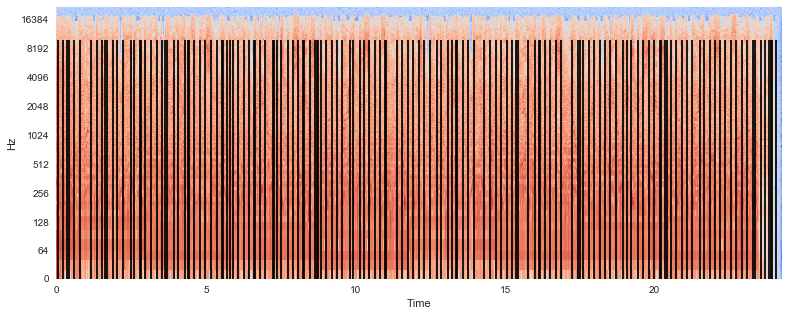

In [48]:
S = librosa.stft(x)
logS = librosa.logamplitude(S)
librosa.display.specshow(logS, sr=sr, x_axis='time', y_axis='log')
plt.vlines(onset_times, 0, 10000, color='k')

As we see in the spectrogram, the detected onsets seem to occur a bit before the actual rise in energy.

Let's listen to these segments. We will create a function to do the following:

1.  Divide the signal into segments beginning at each detected onset.
2.  Pad each segment with 500 ms of silence.
3.  Concatenate the padded segments.

In [49]:
def concatenate_segments(x, onset_samples, pad_duration=0.500):
    """Concatenate segments into one signal."""
    silence = numpy.zeros(int(pad_duration*sr)) # silence
    frame_sz = 8820   # every segment has uniform frame size
    return numpy.concatenate([
        numpy.concatenate([x[i:i+frame_sz], silence]) # pad segment with silence
        for i in onset_samples
    ])

Concatenate the segments:

In [50]:
concatenated_signal = concatenate_segments(x, onset_samples, 0.500)

Listen to the concatenated signal:

In [51]:
ipd.Audio(concatenated_signal, rate=sr)

As we hear, the little glitch between segments occurs because the segment boundaries occur during the attack, not before the attack.

## `librosa.onset.onset_backtrack`

We can avoid this glitch by backtracking from the detected onsets. 

When setting the parameter `backtrack=True`, `librosa.onset.onset_detect` will call [`librosa.onset.onset_backtrack`](http://librosa.github.io/librosa/generated/librosa.onset.onset_backtrack.html).
 For each detected onset, `librosa.onset.onset_backtrack` searches backward for a local minimum.

In [52]:
onset_frames = librosa.onset.onset_detect(x, sr=sr, hop_length=hop_length, backtrack=True)

Convert onsets to units of seconds:

In [53]:
onset_times = librosa.frames_to_time(onset_frames, sr=sr, hop_length=hop_length)

Convert onsets to units of samples:

In [54]:
onset_samples = librosa.frames_to_samples(onset_frames, hop_length=hop_length)

Plot the onsets on top of a spectrogram of the audio:

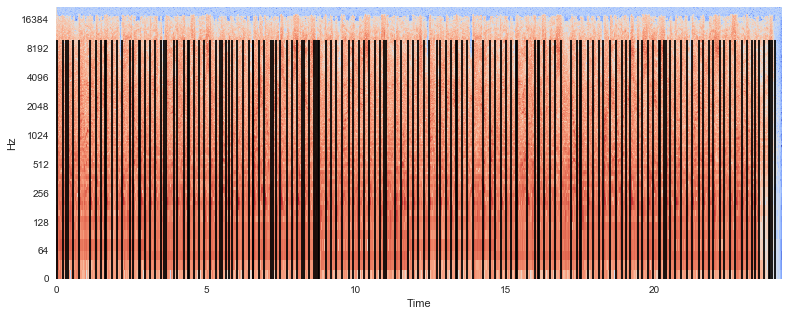

In [55]:
S = librosa.stft(x)
logS = librosa.logamplitude(S)
librosa.display.specshow(logS, sr=sr, x_axis='time', y_axis='log')
plt.vlines(onset_times, 0, 10000, color='k')

Notice how the vertical lines denoting each segment boundary appears before each rise in energy.

Concatenate the segments:

In [56]:
concatenated_signal = concatenate_segments(x, onset_samples, 0.500)

Listen to the concatenated signal:

In [57]:
ipd.Audio(concatenated_signal, rate=sr)

While listening, notice now the segments are perfectly segmented.

## Questions

Try with other audio files:

In [17]:
ls audio

125_bounce.wav         classic_rock_beat.wav  oboe_c6.wav
58bpm.wav              conga_groove.wav       prelude_cmaj.wav
beatbox_steve.wav      funk_groove.mp3        simple_loop.wav
c_strum.wav            jangle_pop.mp3         simple_piano.wav
clarinet_c6.wav        latin_groove.mp3       tone_440.wav


[&larr; Back to Index](index.html)